In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
# from scipy import stats
# sns.set(color_codes=True)

In [2]:
air_pd = pd.read_csv('2015_Air_quality_in_northern_Taiwan.csv')

/anaconda3/envs/tensorflow/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (10,14,18) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


<font size='4'>Show how many real data can be used</font> <br/>
<font size='4'>Total data is 218640, so can find that some feature data is missing a lot.</font>

## This is our feature columns

In [3]:
air_pd.columns

Index(['time', 'station', 'AMB_TEMP', 'CH4', 'CO', 'NMHC', 'NO', 'NO2', 'NOx',
       'O3', 'PH_RAIN', 'PM10', 'PM2.5', 'RAINFALL', 'RAIN_COND', 'RH', 'SO2',
       'THC', 'UVB', 'WD_HR', 'WIND_DIREC', 'WIND_SPEED', 'WS_HR'],
      dtype='object')

In [4]:
air_pd.count()

time          218640
station       218640
AMB_TEMP      200170
CH4            95823
CO            217311
NMHC           95615
NO            217228
NO2           216681
NOx           217229
O3            199865
PH_RAIN        34570
PM10          215761
PM2.5         215768
RAINFALL      208979
RAIN_COND      34570
RH            200244
SO2           217047
THC            95824
UVB            25974
WD_HR         182712
WIND_DIREC    182444
WIND_SPEED    182475
WS_HR         182270
dtype: int64

<font size='4'>Need to change the bad value, like this : 12#, 14x, 5.6* </font>
* \# indicates invalid value by equipment inspection
* \* indicates invalid value by program inspection
* x indicates invalid value by human inspection

In [5]:
def change_badValue(value):
    if value == 'NR':
        value = 0
    if '#' in str(value):
        value = None
    elif 'x' in str(value):
        value = None
    elif '*' in str(value):
        value = None
    return float(value) if value != None else value
air_pd['PM2.5'] = air_pd['PM2.5'].apply(change_badValue)
air_pd['PM2.5'].fillna(value=air_pd['PM2.5'].median(), inplace=True)

## PM2.5 (Air Quality Guide for Particle Pollution)
<table>
    <tr>
        <th colspan="2">Concentrations of fine particulate matter (PM2.5)</th>
    </tr>
    <tr>
        <th>$\mu g/m^3$</th>
        <th>air quality</th>
    </tr>
    <tr>
        <td bgcolor="#7FFF00"> < 15 </td>
        <td bgcolor="#7FFF00">Good</td>
    </tr>
    <tr>
        <td bgcolor="#FFD700">16 - 35</td>
        <td bgcolor="#FFD700">Moderate</td>
    </tr>
    <tr>
        <td bgcolor="#FFA500">36 - 65</td>
        <td bgcolor="#FFA500">Unhealthy for Sensitive Groups</td>
    </tr>
    <tr>
        <td bgcolor="#FF4500"> 66 - 150</td>
        <td bgcolor="#FF4500">Unhealthy</td>
    </tr>
    <tr>
        <td bgcolor="#DDA0DD"> 151 - 250</td>
        <td bgcolor="#DDA0DD">Very Unhealthy Alert</td>
    </tr>
    <tr>
        <td bgcolor="#D02090"> 251 - </td>
        <td bgcolor="#D02090">Hazardous</td>
    </tr>
</table>

<font size='4'>We can see Taiwan is in moderate degree, not to good</font>

count    218640.000000
mean         18.463053
std          13.112201
min           0.000000
25%          10.000000
50%          16.000000
75%          24.000000
max         131.000000
Name: PM2.5, dtype: float64


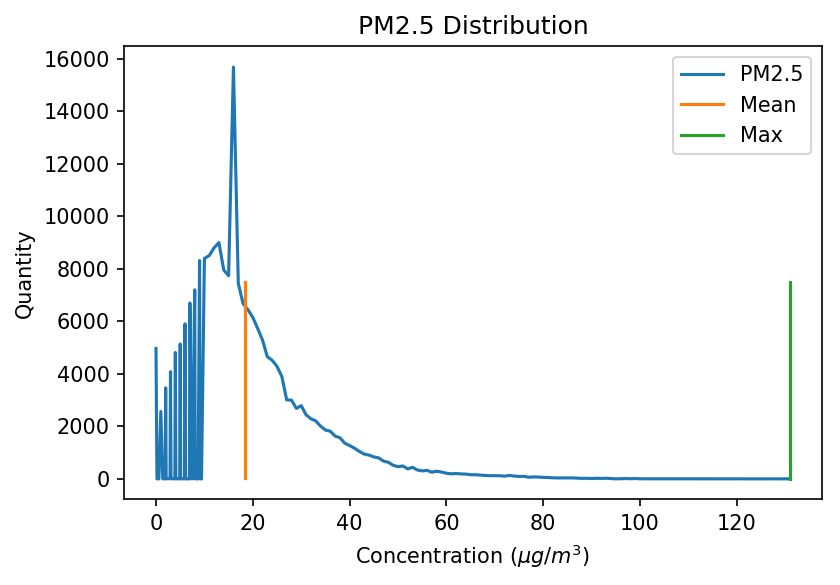

In [6]:
print(air_pd['PM2.5'].describe())
plt.figure(dpi=150)
plt.plot(air_pd['PM2.5'].value_counts().sort_index())
plt.plot([air_pd['PM2.5'].mean()]*2, [20, 7500], label='Mean')
plt.plot([air_pd['PM2.5'].max()]*2,[0, 7500], label='Max')
plt.title('PM2.5 Distribution')
plt.xlabel('Concentration ($\mu g/m^3$)')
plt.ylabel('Quantity')
plt.legend()
# plt.savefig('./image/1.png')

In [7]:
print('Before %d' %len(air_pd))
air_pd = air_pd[air_pd['PM2.5'].notna()]
print('After %d' %len(air_pd))
air_pd.info()

Before 218640
After 218640
<class 'pandas.core.frame.DataFrame'>
Int64Index: 218640 entries, 0 to 218639
Data columns (total 23 columns):
time          218640 non-null object
station       218640 non-null object
AMB_TEMP      200170 non-null object
CH4           95823 non-null object
CO            217311 non-null object
NMHC          95615 non-null object
NO            217228 non-null object
NO2           216681 non-null object
NOx           217229 non-null object
O3            199865 non-null object
PH_RAIN       34570 non-null object
PM10          215761 non-null object
PM2.5         218640 non-null float64
RAINFALL      208979 non-null object
RAIN_COND     34570 non-null object
RH            200244 non-null object
SO2           217047 non-null object
THC           95824 non-null object
UVB           25974 non-null object
WD_HR         182712 non-null object
WIND_DIREC    182444 non-null object
WIND_SPEED    182475 non-null object
WS_HR         182270 non-null object
dtypes: float64(

###  Our dataset has many null values, so we need to find what the feature is invalid
Count NA ratio, determine what feature is invalid data

In [8]:
na_ratio = (air_pd.isna().sum() / len(air_pd)).sort_values(ascending=False)
na_ratio

UVB           0.881202
RAIN_COND     0.841886
PH_RAIN       0.841886
NMHC          0.562683
CH4           0.561732
THC           0.561727
WS_HR         0.166347
WIND_DIREC    0.165551
WIND_SPEED    0.165409
WD_HR         0.164325
O3            0.085872
AMB_TEMP      0.084477
RH            0.084138
RAINFALL      0.044187
PM10          0.013168
NO2           0.008960
SO2           0.007286
NO            0.006458
NOx           0.006454
CO            0.006078
PM2.5         0.000000
station       0.000000
time          0.000000
dtype: float64

<font size='4'>Set the threshold 0.5, then can find what's the feature over than 0.5</font>
* UVB
* RAIN_COND
* PH_RAIN
* NMHC
* CH4
* THC   

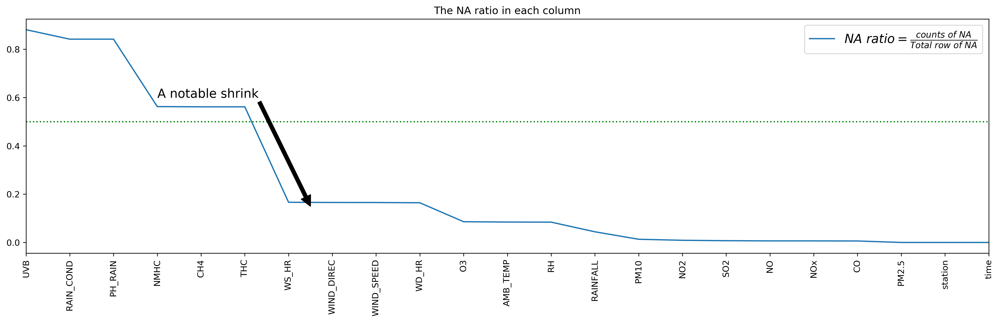

In [9]:
plt.figure(figsize=(20,5),dpi=300)
plt.title('The NA ratio in each column')
plt.xticks(rotation='vertical')
plt.plot([0,22],[0.5,0.5],'g:')   ## na threshold
plt.plot((air_pd.isna().sum() / len(air_pd)).sort_values(ascending=False).index,
         (air_pd.isna().sum() / len(air_pd)).sort_values(ascending=False).values,'-',label=r'$NA \ ratio = \frac{counts \ of \ NA}{Total \ row \ of \ NA}$')
plt.annotate('A notable shrink', xy=(6.5, 0.15), xytext=(3, 0.6),fontsize='x-large',
            arrowprops={'facecolor':'black','shrink':1.0}
            )
plt.xlim(0,22)
plt.legend(fontsize='x-large')
# plt.savefig('./image/2')

<font size='4'>**UVB, RAIN_COND, PH_RAIN** is over 80% is na value, those feature have few information, so need to delete.</font> <br/>
<font size='4'>Take off this feature, because it has many NR value, so it has less real value to analyze.</font>

In [10]:
air_pd.drop(['UVB','PH_RAIN', 'RAIN_COND'], axis=1, inplace=True)

### We choice the less NA feature(CO), so we can find if CO is NA , other feature will be NA

In [11]:
air_pd[air_pd['CO'].isna()].head()

,time,station,AMB_TEMP,CH4,CO,NMHC,NO,NO2,NOx,O3,PM10,PM2.5,RAINFALL,RH,SO2,THC,WD_HR,WIND_DIREC,WIND_SPEED,WS_HR
466,2015/01/20 10:00,Banqiao,19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,92,40.0,NR,55,NaN,NaN,67,68,4,3
1097,2015/02/15 17:00,Banqiao,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1098,2015/02/15 18:00,Banqiao,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1099,2015/02/15 19:00,Banqiao,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1100,2015/02/15 20:00,Banqiao,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<font size='4'>Plot this figure, many row have 3 null value, so we need to filter the rows if it has many null values</font>

(0, 225701.15)

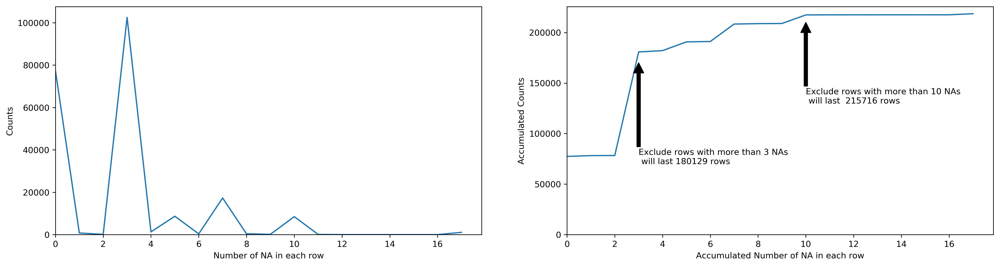

In [12]:
plt.figure(figsize=(20, 5), dpi=300)
plt.subplot(121)
plt.plot(air_pd.isna().sum(axis=1).value_counts().sort_index())
plt.xlabel('Number of NA in each row')
plt.ylabel('Counts')
plt.xlim(0)
plt.ylim(0)

plt.subplot(122)
plt.plot(air_pd.isna().sum(axis=1).value_counts().sort_index().cumsum())
plt.annotate('Exclude rows with more than 10 NAs \n will last  215716 rows', xy=(10, 210000), xytext=(10, 130000),
             fontsize='medium',arrowprops={'facecolor':'black','shrink':1.0})
plt.annotate('Exclude rows with more than 3 NAs \n will last 180129 rows', xy=(3, 170000), xytext=(3, 70000),
             fontsize='medium',arrowprops={'facecolor':'black','shrink':1.0})
plt.xlabel('Accumulated Number of NA in each row')
plt.ylabel('Accumulated Counts')
plt.xlim(0)
plt.ylim(0)
# plt.savefig('./image/3.png')

<font size='4'>We can drop the NA row, because this row has few information</font> <br/> 
<font size='4'>We choose 3 null field reserved</font>

In [13]:
print("Before : %d" %(len(air_pd)))
air_pd = air_pd.dropna(thresh=len(air_pd.columns) - 3)  #remove all column if there is non-'NaN' value is less than 17
print("After : %d" %(len(air_pd)))

Before : 218640
After : 180806


<font size='4'>Change the invalid value (12#, 1*, 0.5x),and then null value fills median </font>

In [14]:
columns = [na_ratio.index[index] for index, na in enumerate(na_ratio.values) if na < 0.5 and na > 0]
print(columns)
for col in columns:
    air_pd[col] = air_pd[col].apply(change_badValue)
    air_pd[col].fillna(value=air_pd[col].median(), inplace=True)
    
air_pd

['WS_HR', 'WIND_DIREC', 'WIND_SPEED', 'WD_HR', 'O3', 'AMB_TEMP', 'RH', 'RAINFALL', 'PM10', 'NO2', 'SO2', 'NO', 'NOx', 'CO']


,time,station,AMB_TEMP,CH4,CO,NMHC,NO,NO2,NOx,O3,PM10,PM2.5,RAINFALL,RH,SO2,THC,WD_HR,WIND_DIREC,WIND_SPEED,WS_HR
0,2015/01/01 00:00,Banqiao,16.0,2.1,0.79,0.14,1.2,16.0,17.0,37.0,177.0,16.0,0.0,57.0,12.0,2.2,69.0,69.0,4.7,4.2
1,2015/01/01 01:00,Banqiao,16.0,2.1,0.80,0.15,1.3,16.0,17.0,36.0,178.0,16.0,0.0,57.0,11.0,2.2,67.0,65.0,4.0,4.0
2,2015/01/01 02:00,Banqiao,16.0,2.1,0.71,0.13,1.0,13.0,14.0,38.0,163.0,16.0,0.0,57.0,8.0,2.2,63.0,53.0,3.7,3.5
3,2015/01/01 03:00,Banqiao,15.0,2,0.66,0.12,0.8,11.0,12.0,39.0,147.0,16.0,0.0,58.0,6.5,2.2,63.0,63.0,4.1,3.3
4,2015/01/01 04:00,Banqiao,15.0,2,0.53,0.11,0.6,10.0,11.0,38.0,131.0,16.0,0.0,58.0,5.5,2.1,69.0,67.0,3.0,3.1
5,2015/01/01 05:00,Banqiao,14.0,2,0.50,0.11,0.8,11.0,12.0,37.0,112.0,16.0,0.0,57.0,5.7,2.1,68.0,62.0,2.9,3.3
6,2015/01/01 06:00,Banqiao,14.0,2,0.57,0.14,1.4,18.0,19.0,29.0,103.0,16.0,0.0,57.0,5.8,2.1,74.0,70.0,3.6,2.2
7,2015/01/01 07:00,Banqiao,14.0,2,0.61,0.14,2.3,17.0,20.0,27.0,104.0,16.0,0.0,56.0,6.5,2.2,66.0,72.0,3.1,3.0
8,2015/01/01 08:00,Banqiao,14.0,2,0.59,0.13,2.9,15.0,18.0,29.0,111.0,16.0,0.0,53.0,6.8,2.1,71.0,73.0,2.8,3.3
9,2015/01/01 09:00,Banqiao,14.0,2,0.60,0.14,4.1,16.0,20.0,29.0,111.0,16.0,0.0,50.0,5.9,2.1,73.0,68.0,3.6,3.2


column | NA
---- | ---
NMHC | 0.560051
THC | 0.560051
CH4 |  0.559230


<font size='4'>So we need to discuss the NMHC, CH4 and THC, they have near 0.5 NA ratio  </font>
* NMHC :  mean Non-Methane Hydrocarbon
* THC : Total Hydrocarbons   
* CH4 : Methane 


So we can make a assumption   
<font size='4'>&rArr;         $THC = CH4 + NHMC$ </font> <br/>

First, find the THC's null values, then use **CH4 + NHMC** to fill the vacancy 

<font color="#660000" size='3'>So bad, not find anyone, it means THC & CH4 & NMHC have the number in the same time </font><br />

In [15]:
np.where(air_pd['THC'].isna() & air_pd['CH4'].notna() & air_pd['NMHC'].notna())

(array([], dtype=int64),)

<font size='4'>From the distribution map, we can see that our assumptions are correct.</font>

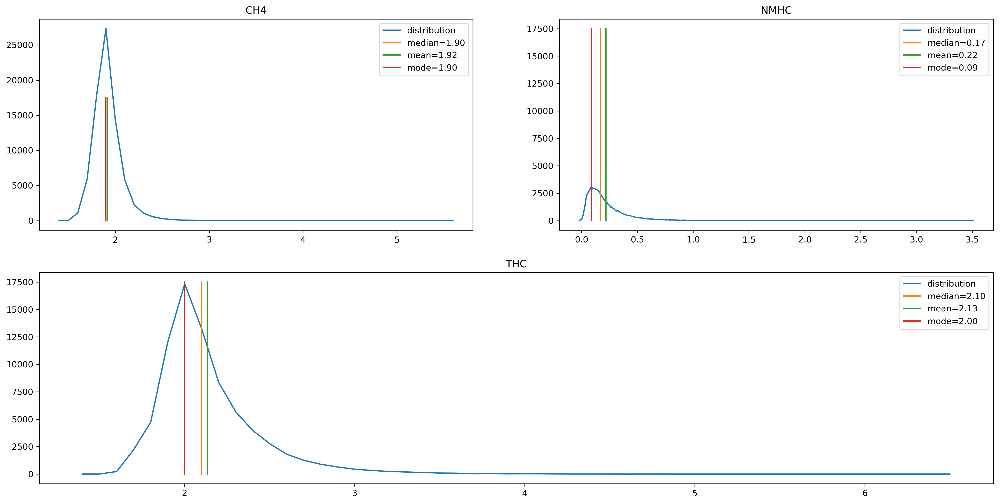

In [16]:
plt.figure(figsize=(20, 10), dpi=300)
plt.subplot(221)
plt.plot(air_pd['CH4'].apply(change_badValue).value_counts().sort_index(), label='distribution')
plt.plot([air_pd['CH4'].apply(change_badValue).median()]*2, [0, 17500], label='median=%.2f'%(air_pd['CH4'].apply(change_badValue).median()))
plt.plot([air_pd['CH4'].apply(change_badValue).mean()]*2, [0, 17500], label='mean=%.2f'%(air_pd['CH4'].apply(change_badValue).mean()))
plt.plot([air_pd['CH4'].apply(change_badValue).mode()]*2, [0, 17500], label='mode=%.2f'%(air_pd['CH4'].apply(change_badValue).mode()))
plt.title('CH4')
plt.legend()

plt.subplot(222)
plt.plot(air_pd['NMHC'].apply(change_badValue).value_counts().sort_index(), label='distribution')
plt.plot([air_pd['NMHC'].apply(change_badValue).median()]*2, [0, 17500], label='median=%.2f'%(air_pd['NMHC'].apply(change_badValue).median()))
plt.plot([air_pd['NMHC'].apply(change_badValue).mean()]*2, [0, 17500], label='mean=%.2f'%(air_pd['NMHC'].apply(change_badValue).mean()))
plt.plot([air_pd['NMHC'].apply(change_badValue).mode()]*2, [0, 17500], label='mode=%.2f'%(air_pd['NMHC'].apply(change_badValue).mode()))
plt.title('NMHC')
plt.legend()

plt.subplot(212)
plt.plot(air_pd['THC'].apply(change_badValue).value_counts().sort_index(), label='distribution')
plt.plot([air_pd['THC'].apply(change_badValue).median()]*2, [0, 17500], label='median=%.2f'%(air_pd['THC'].apply(change_badValue).median()))
plt.plot([air_pd['THC'].apply(change_badValue).mean()]*2, [0, 17500], label='mean=%.2f'%(air_pd['THC'].apply(change_badValue).mean()))
plt.plot([air_pd['THC'].apply(change_badValue).mode()]*2, [0, 17500], label='mode=%.2f'%(air_pd['THC'].apply(change_badValue).mode()))
plt.title('THC')
plt.legend()
# plt.savefig('./image/4')

In [17]:
for col in ['THC', 'NMHC', 'CH4']:
    air_pd[col] = air_pd[col].apply(change_badValue)
    air_pd[col].fillna(value=air_pd[col].median(), inplace=True)
air_pd

,time,station,AMB_TEMP,CH4,CO,NMHC,NO,NO2,NOx,O3,PM10,PM2.5,RAINFALL,RH,SO2,THC,WD_HR,WIND_DIREC,WIND_SPEED,WS_HR
0,2015/01/01 00:00,Banqiao,16.0,2.1,0.79,0.14,1.2,16.0,17.0,37.0,177.0,16.0,0.0,57.0,12.0,2.2,69.0,69.0,4.7,4.2
1,2015/01/01 01:00,Banqiao,16.0,2.1,0.80,0.15,1.3,16.0,17.0,36.0,178.0,16.0,0.0,57.0,11.0,2.2,67.0,65.0,4.0,4.0
2,2015/01/01 02:00,Banqiao,16.0,2.1,0.71,0.13,1.0,13.0,14.0,38.0,163.0,16.0,0.0,57.0,8.0,2.2,63.0,53.0,3.7,3.5
3,2015/01/01 03:00,Banqiao,15.0,2.0,0.66,0.12,0.8,11.0,12.0,39.0,147.0,16.0,0.0,58.0,6.5,2.2,63.0,63.0,4.1,3.3
4,2015/01/01 04:00,Banqiao,15.0,2.0,0.53,0.11,0.6,10.0,11.0,38.0,131.0,16.0,0.0,58.0,5.5,2.1,69.0,67.0,3.0,3.1
5,2015/01/01 05:00,Banqiao,14.0,2.0,0.50,0.11,0.8,11.0,12.0,37.0,112.0,16.0,0.0,57.0,5.7,2.1,68.0,62.0,2.9,3.3
6,2015/01/01 06:00,Banqiao,14.0,2.0,0.57,0.14,1.4,18.0,19.0,29.0,103.0,16.0,0.0,57.0,5.8,2.1,74.0,70.0,3.6,2.2
7,2015/01/01 07:00,Banqiao,14.0,2.0,0.61,0.14,2.3,17.0,20.0,27.0,104.0,16.0,0.0,56.0,6.5,2.2,66.0,72.0,3.1,3.0
8,2015/01/01 08:00,Banqiao,14.0,2.0,0.59,0.13,2.9,15.0,18.0,29.0,111.0,16.0,0.0,53.0,6.8,2.1,71.0,73.0,2.8,3.3
9,2015/01/01 09:00,Banqiao,14.0,2.0,0.60,0.14,4.1,16.0,20.0,29.0,111.0,16.0,0.0,50.0,5.9,2.1,73.0,68.0,3.6,3.2


<font size='4'>Check noone is NA</font>

In [18]:
np.where(air_pd.isna())

(array([], dtype=int64), array([], dtype=int64))

### Separate the date time

In [19]:
air_pd['year'] = pd.to_datetime(air_pd['time']).dt.year
air_pd['month'] = pd.to_datetime(air_pd['time']).dt.month
air_pd['day'] = pd.to_datetime(air_pd['time']).dt.day
air_pd['hour'] = pd.to_datetime(air_pd['time']).dt.hour
air_pd

,time,station,AMB_TEMP,CH4,CO,NMHC,NO,NO2,NOx,O3,...,SO2,THC,WD_HR,WIND_DIREC,WIND_SPEED,WS_HR,year,month,day,hour
0,2015/01/01 00:00,Banqiao,16.0,2.1,0.79,0.14,1.2,16.0,17.0,37.0,...,12.0,2.2,69.0,69.0,4.7,4.2,2015,1,1,0
1,2015/01/01 01:00,Banqiao,16.0,2.1,0.80,0.15,1.3,16.0,17.0,36.0,...,11.0,2.2,67.0,65.0,4.0,4.0,2015,1,1,1
2,2015/01/01 02:00,Banqiao,16.0,2.1,0.71,0.13,1.0,13.0,14.0,38.0,...,8.0,2.2,63.0,53.0,3.7,3.5,2015,1,1,2
3,2015/01/01 03:00,Banqiao,15.0,2.0,0.66,0.12,0.8,11.0,12.0,39.0,...,6.5,2.2,63.0,63.0,4.1,3.3,2015,1,1,3
4,2015/01/01 04:00,Banqiao,15.0,2.0,0.53,0.11,0.6,10.0,11.0,38.0,...,5.5,2.1,69.0,67.0,3.0,3.1,2015,1,1,4
5,2015/01/01 05:00,Banqiao,14.0,2.0,0.50,0.11,0.8,11.0,12.0,37.0,...,5.7,2.1,68.0,62.0,2.9,3.3,2015,1,1,5
6,2015/01/01 06:00,Banqiao,14.0,2.0,0.57,0.14,1.4,18.0,19.0,29.0,...,5.8,2.1,74.0,70.0,3.6,2.2,2015,1,1,6
7,2015/01/01 07:00,Banqiao,14.0,2.0,0.61,0.14,2.3,17.0,20.0,27.0,...,6.5,2.2,66.0,72.0,3.1,3.0,2015,1,1,7
8,2015/01/01 08:00,Banqiao,14.0,2.0,0.59,0.13,2.9,15.0,18.0,29.0,...,6.8,2.1,71.0,73.0,2.8,3.3,2015,1,1,8
9,2015/01/01 09:00,Banqiao,14.0,2.0,0.60,0.14,4.1,16.0,20.0,29.0,...,5.9,2.1,73.0,68.0,3.6,3.2,2015,1,1,9


[The NEWS - PM2.5達「非常高」 桃園、平鎮和龍潭民眾少外出](https://news.ltn.com.tw/news/life/breakingnews/1541461)

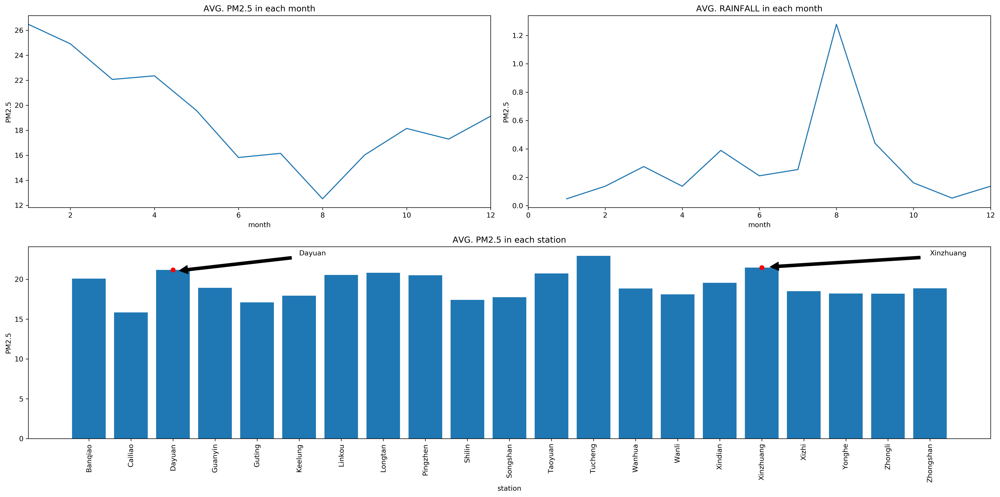

In [20]:
plt.figure(figsize=(20,10),dpi=300)
plt.subplot(2,2,1)
plt.title('AVG. PM2.5 in each month')
plt.plot(air_pd.groupby('month').mean()['PM2.5'])
plt.xlim(1,12)
plt.xlabel('month')
plt.ylabel('PM2.5')


plt.subplot(2,2,2)
plt.title('AVG. RAINFALL in each month')
plt.plot(air_pd.groupby('month').mean()['RAINFALL'])
plt.xlim(0,12)
plt.xlabel('month')
plt.ylabel('PM2.5')

# plt.subplot(2,2,2)
# plt.title('AVG. PM2.5 in each hour')
# plt.plot(air_pd.groupby('hour').mean()['PM2.5'])
# plt.xlim(0,23)
# plt.xlabel('hour')
# plt.ylabel('PM2.5')

plt.subplot(2,1,2)
plt.title('AVG. PM2.5 in each station')
plt.bar(air_pd.groupby('station').mean().index, air_pd.groupby('station').mean()['PM2.5'])
plt.annotate('Dayuan', xy=(2, 21),xytext=(5, 23),arrowprops=dict(facecolor='black', shrink=0.05))
plt.annotate('Xinzhuang', xy=(16, 21.5),xytext=(20, 23),arrowprops=dict(facecolor='black', shrink=0.05))
plt.plot([2],[21.17],'ro')
plt.plot([16],[21.47],'ro')
plt.xticks(rotation='vertical')
plt.xlabel('station')
plt.ylabel('PM2.5')
plt.tight_layout()
# plt.savefig('./image/05')

In [21]:
continous_columns = air_pd.columns[2:-4]
discrete_columns=['station','year','month','day','hour']

In [22]:
plt.figure(figsize=(20,60), dpi=500)
for number,col in enumerate(continous_columns):
    plt.subplot(18,1,number+1)
    sns.distplot(air_pd[col])
    ### 存圖
#     plt.figure(figsize=(20,10), dpi=250)
#     sns.distplot(air_pd[col])
# plt.savefig('./image/distribution'.format(number + 6))
plt.tight_layout()

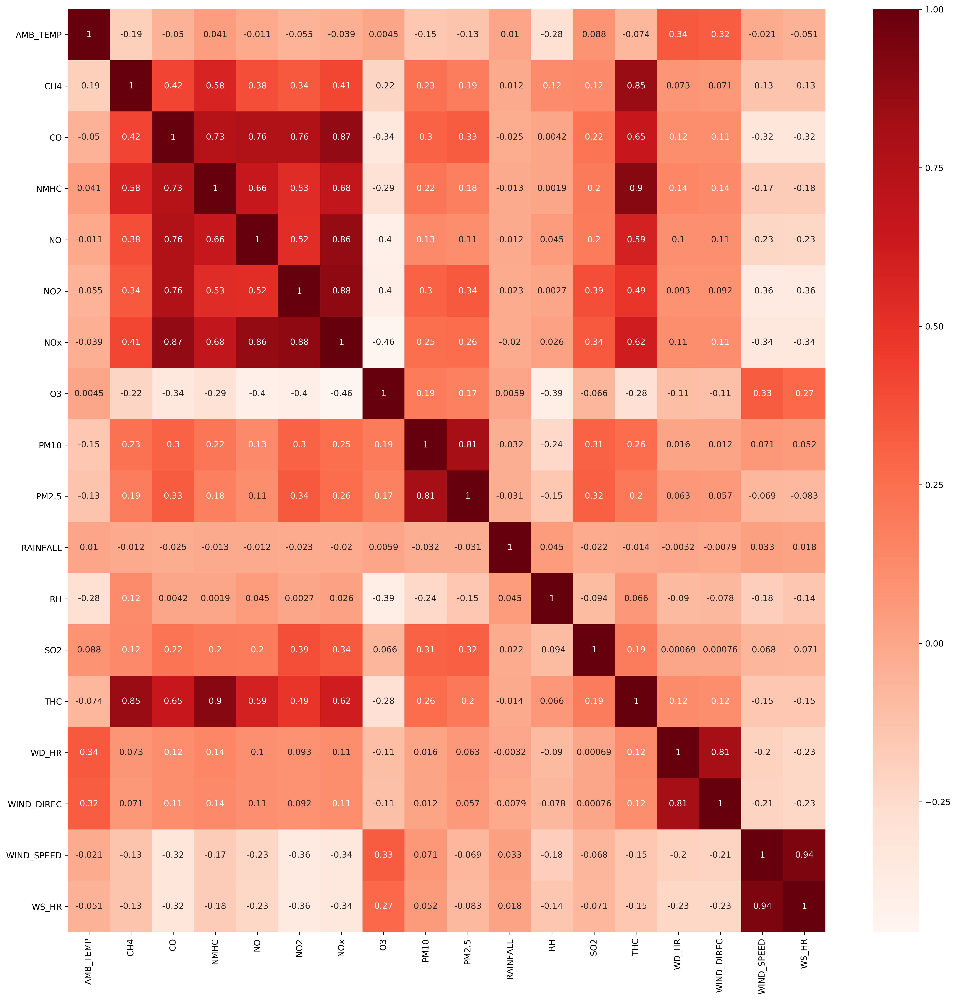

In [23]:
plt.figure(figsize=(20,20), dpi=300)
hm=sns.heatmap(air_pd[continous_columns].corr().values,annot=True,
               xticklabels=continous_columns,
               yticklabels=continous_columns,
               cmap='Reds')
# plt.savefig('./image/24')

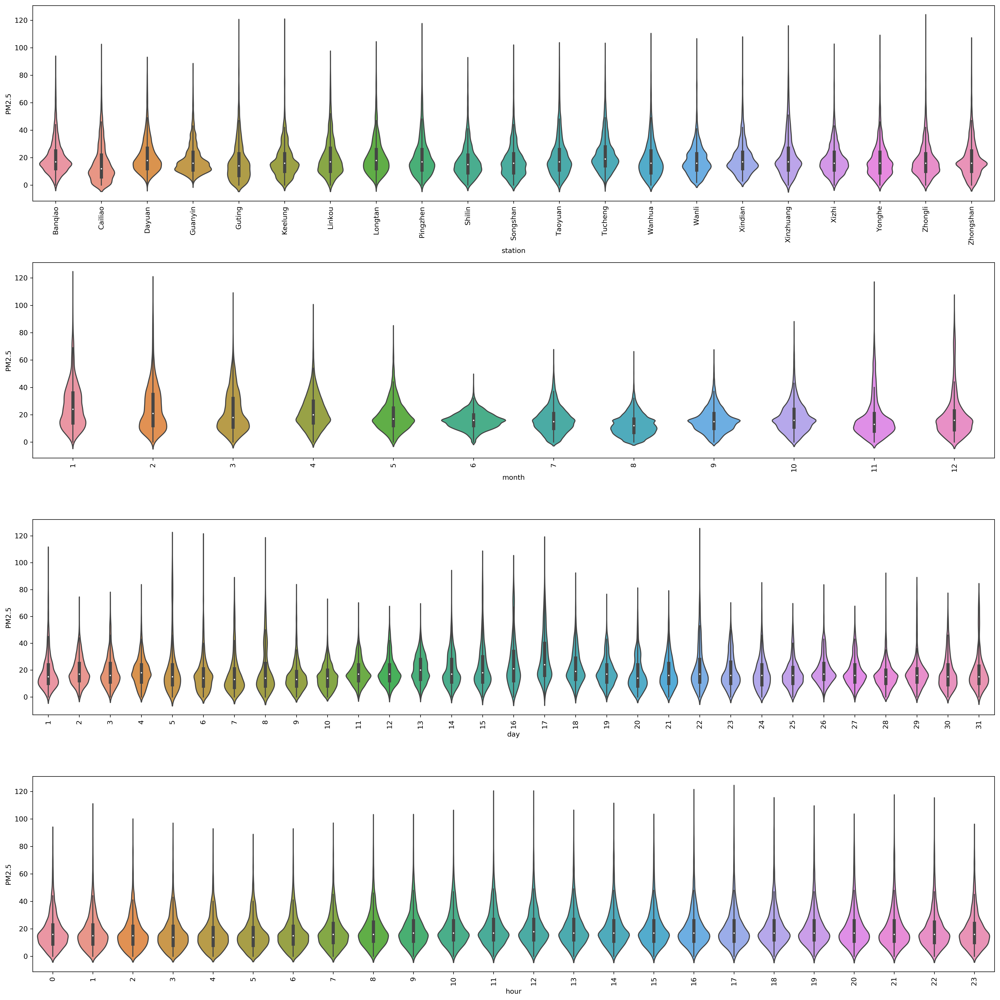

In [24]:
plt.figure(figsize=(20,20), dpi=300)
for number,col in enumerate(['station','month','day','hour']):
    plt.subplot(4,1,number+1)
    plt.xticks(rotation='vertical')
    sns.violinplot(air_pd[col],air_pd['PM2.5'])
    ### 存圖
#     plt.figure(figsize=(20,10), dpi=250)
#     plt.xticks(rotation='vertical')
#     sns.violinplot(air_pd[col],air_pd['PM2.5'])
# plt.savefig('./image/violin')
plt.tight_layout()    

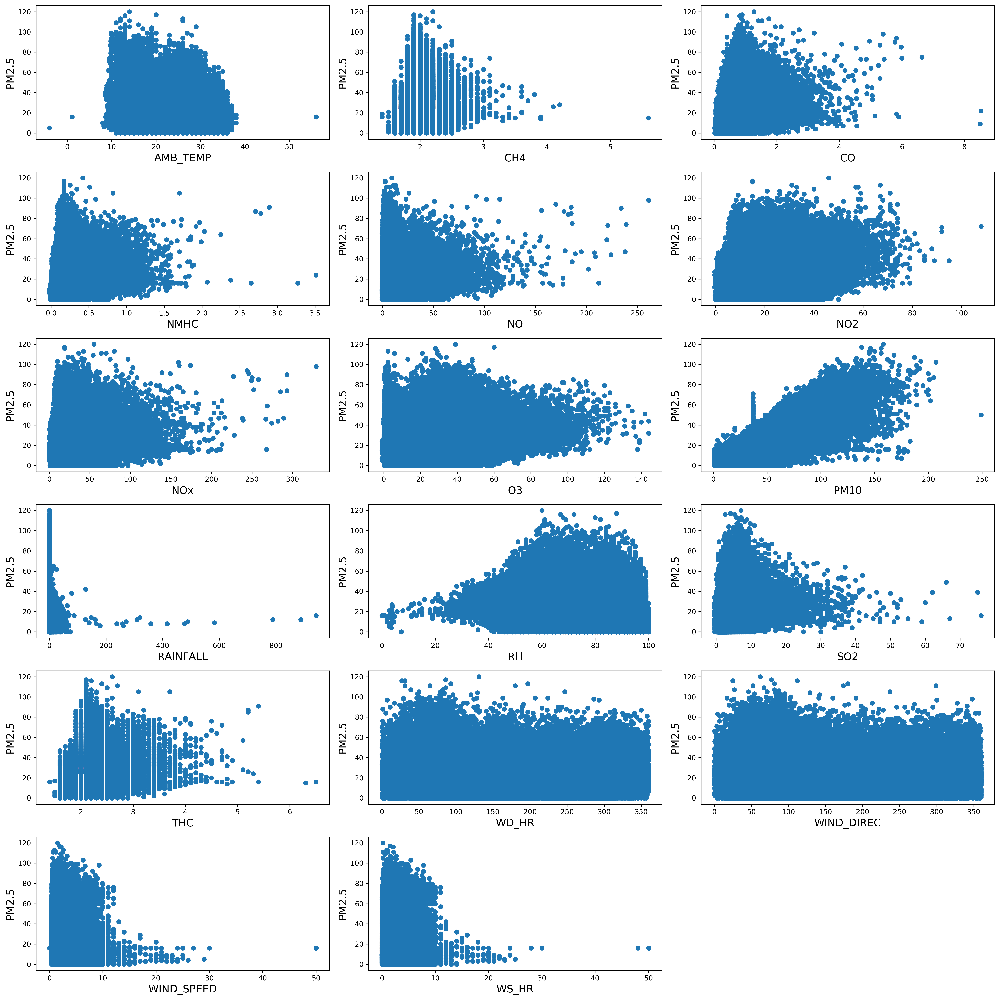

In [25]:
plt.figure(figsize=(20,20), dpi=300)
number = 0
for i,j in zip(continous_columns.drop('PM2.5'),np.arange(len(continous_columns.drop('PM2.5')))):
    plt.subplot(6,3,j+1)       
    plt.scatter(air_pd[i],air_pd['PM2.5'])
    plt.xlabel(i, fontsize=15)
    plt.ylabel('PM2.5', fontsize=15)
    ## 存圖
#     plt.figure(figsize=(20,10), dpi=300)
#     plt.scatter(air_pd[i],np.log(air_pd['PM2.5']))
#     plt.xlabel(i, fontsize=15)
#     plt.ylabel('PM2.5', fontsize=15)
#     plt.savefig('./image/{}'.format(number + 29))
#     number+=1
plt.tight_layout()    
plt.show()

# Concentration status of each region
<font size='4'>Read shapefile, then use the county name and town name to show our purpose</font>
* [Taiwan Shapefile](https://gadm.org/download_country_v3.html) 
* [台灣各鄉(鎮、市、區)行政區域界線圖資](https://data.gov.tw/dataset/7441)

In [26]:
import geopandas as gpd
##Read shapefile, then use the county name and town name to show our purpose
taiwan = gpd.read_file('./gadm36_TWN_shp/TOWN_MOI_1080509.shp', encoding='utf-8') 
taiwan

,TOWNID,TOWNCODE,COUNTYNAME,TOWNNAME,TOWNENG,COUNTYID,COUNTYCODE,geometry
0,V02,10014020,臺東縣,成功鎮,Chenggong Township,V,10014,"POLYGON ((121.409815737 23.21369278500009, 121..."
1,T21,10013210,屏東縣,佳冬鄉,Jiadong Township,T,10013,"POLYGON ((120.5484580210001 22.46067220300006,..."
2,P13,10009130,雲林縣,麥寮鄉,Mailiao Township,P,10009,"POLYGON ((120.3019750420001 23.81624614400005,..."
3,V11,10014110,臺東縣,綠島鄉,Lvdao Township,V,10014,"(POLYGON ((121.491547243 22.67745703900005, 12..."
4,V16,10014160,臺東縣,蘭嶼鄉,Lanyu Township,V,10014,(POLYGON ((121.6117956420001 21.94289657000007...
5,N07,10007120,彰化縣,田中鎮,Tianzhong Township,N,10007,"POLYGON ((120.5825012830001 23.87649871400004,..."
6,N19,10007170,彰化縣,社頭鄉,Shetou Township,N,10007,"POLYGON ((120.5855840500001 23.87687077200007,..."
7,T14,10013140,屏東縣,竹田鄉,Zhutian Township,T,10013,"POLYGON ((120.5046145120001 22.57314658000007,..."
8,T05,10013050,屏東縣,萬丹鄉,Wandan Township,T,10013,"POLYGON ((120.5046145120001 22.57314658000007,..."
9,K13,10005160,苗栗縣,三灣鄉,Sanwan Township,K,10005,"POLYGON ((121.008084123 24.64440071800004, 121..."


<font size='4'>Manually change the area</font>    

Modify according to the geographic name in the shapefile

In [27]:
district = ['Banqiao District', 'Songshan District', 'Dayuan District', 'Guanyin District', 'Zhongzheng District', 'Keelung City',
'Linkou District', 'Longtan District', 'Pingzhen District', 'Shilin District', 'Songshan District', 'Taoyuan District',
'Tucheng District', 'Wanhua District', 'Wanli District', 'Xindian District', 'Xinzhuang District', 'Xizhi District',
'Yonghe District', 'Zhongli District', 'Zhongshan District']

## check which one not in taiwan map
i = 0
print('Before total : %d' %len(district))
for item in district:
    try:
        if np.where(taiwan['TOWNENG'] == item)[0]:
            i += 1
            print('good')
        else:
            print("No this name : {}" .format(item))
    except ValueError:
        i+=1
        print('has, but has many items')
print('After total: %d' %i)

Before total : 21
good
good
good
good
has, but has many items
No this name : Keelung City
good
good
good
good
good
has, but has many items
good
good
good
good
good
good
good
good
has, but has many items
After total: 20


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel_launcher.py:11: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  # This is added back by InteractiveShellApp.init_path()


In [28]:
## Get the average concentration of each region
pm = air_pd.groupby('station').mean()['PM2.5']  
print(pm)
## change the area name
pm.index  = district
print(pm.index)
## set the column name - TOWNENG, then get the new dataframe
pm = pm.rename_axis('TOWNENG')
pm = pm.reset_index()
pm

station
Banqiao      20.088030
Cailiao      15.845786
Dayuan       21.173681
Guanyin      18.929024
Guting       17.096326
Keelung      17.949713
Linkou       20.540312
Longtan      20.815722
Pingzhen     20.510242
Shilin       17.420776
Songshan     17.748882
Taoyuan      20.741494
Tucheng      22.949262
Wanhua       18.854126
Wanli        18.104848
Xindian      19.554026
Xinzhuang    21.473666
Xizhi        18.505247
Yonghe       18.221193
Zhongli      18.202040
Zhongshan    18.857110
Name: PM2.5, dtype: float64
Index(['Banqiao District', 'Songshan District', 'Dayuan District',
       'Guanyin District', 'Zhongzheng District', 'Keelung City',
       'Linkou District', 'Longtan District', 'Pingzhen District',
       'Shilin District', 'Songshan District', 'Taoyuan District',
       'Tucheng District', 'Wanhua District', 'Wanli District',
       'Xindian District', 'Xinzhuang District', 'Xizhi District',
       'Yonghe District', 'Zhongli District', 'Zhongshan District'],
      dtype='o

,TOWNENG,PM2.5
0,Banqiao District,20.088030
1,Songshan District,15.845786
2,Dayuan District,21.173681
3,Guanyin District,18.929024
4,Zhongzheng District,17.096326
5,Keelung City,17.949713
6,Linkou District,20.540312
7,Longtan District,20.815722
8,Pingzhen District,20.510242
9,Shilin District,17.420776


In [29]:
taiwan = pd.merge(taiwan, pm, how='left', on=['TOWNENG'])   ## merged according to TOWNENG
taiwan.fillna(0, inplace=True)   ## fill null value to zero
## filter out the north area
north = taiwan[(taiwan['COUNTYNAME'] == '臺北市') | (taiwan['COUNTYNAME'] == '新北市') | (taiwan['COUNTYNAME'] == '基隆市') | (taiwan['COUNTYNAME'] == '桃園市')]

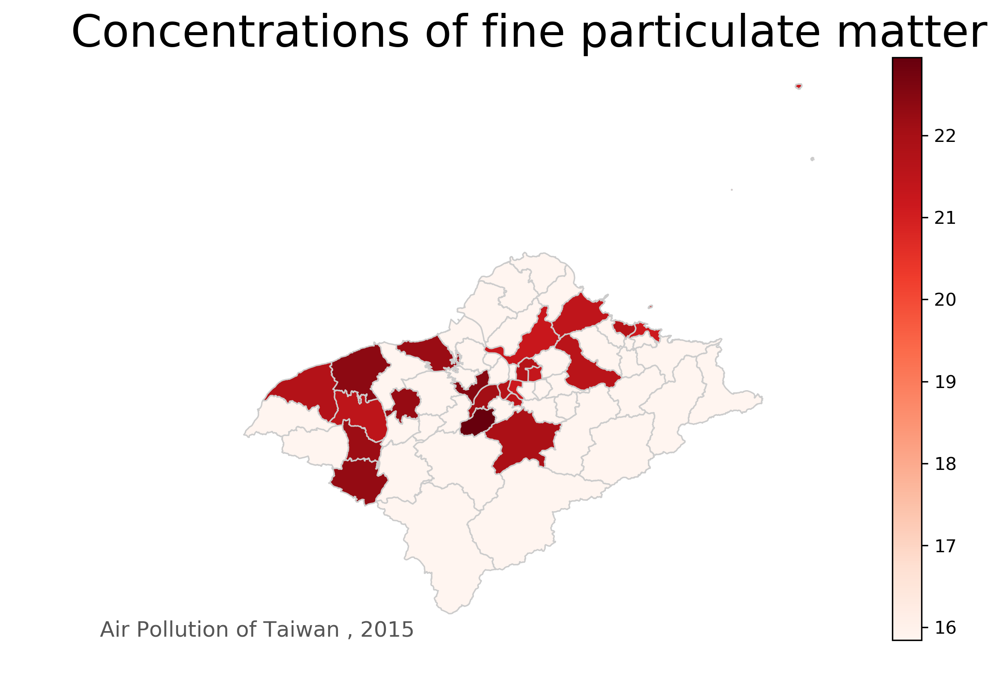

In [30]:
variable = 'PM2.5'
fig, ax = plt.subplots(1, figsize=(10, 6), dpi=300)
vmin, vmax = pm.min().values[1], pm.max().values[1]
# remove the axis
ax.axis('off')

# add a title
ax.set_title('Concentrations of fine particulate matter', fontdict={'fontsize': '25', 'fontweight' : '3'})

# create an annotation for the data source
ax.annotate('Air Pollution of Taiwan , 2015',xy=(0.1, .08),  xycoords='figure fraction', fontsize=12, color='#555555')
north.plot(column=variable, cmap='Reds', linewidth=0.8, ax=ax, edgecolor='0.8')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Reds', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm)
# plt.savefig('./image/46')


=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 18.33652084757348
=================== SVR ========================
Training time= 1.79
MSE 59.358887747767426
MSE 59.358887747767426
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 17.861260387811633
=================== SVR ========================
Training time= 1.92
MSE 64.87566935610906
MSE 64.87566935610906
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 20.277064606741575
=================== SVR ========================
Training time= 1.20
MSE 111.64152112367806
MSE 111.64152112367806
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 5.80990291262136
=================== SVR ========================
Training time= 2.45
MSE 33.67766432339082
MSE 33.67766432339082
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 22.83832762165867
=================== SVR ========================
Training time= 1.34
MSE 77.5759294683557
MSE 77.5759294683557
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 44.65576519916143
=================== SVR ========================
Training time= 1.95
MSE 105.78186715664296
MSE 105.78186715664296
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 19.944555712270805
=================== SVR ========================
Training time= 18.49
MSE 83.91535156456307
MSE 83.91535156456307
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 31.89862947658402
=================== SVR ========================
Training time= 17.85
MSE 105.96482580288564
MSE 105.96482580288564
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 37.988721492743615
=================== SVR ========================
Training time= 19.06
MSE 104.96167213461686
MSE 104.96167213461686
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Training time= 0.00
MSE 22.40383608815427
=================== SVR ========================
Training time= 1.80
MSE 80.70728915464484
MSE 80.70728915464484
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Training time= 0.00
MSE 26.720103092783503
=================== SVR ========================
Training time= 2.12
MSE 85.97267420353782
MSE 85.97267420353782
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 30.766614227086183
=================== SVR ========================
Training time= 1.50
MSE 99.89740312681359
MSE 99.89740312681359
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 20.026794258373208
=================== SVR ========================
Training time= 0.90
MSE 48.306001933805256
MSE 48.306001933805256
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 31.505079365079364
=================== SVR ========================
Training time= 1.34
MSE 117.85517098486145
MSE 117.85517098486145
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 14.495304709141275
=================== SVR ========================
Training time= 1.82
MSE 51.180040380682534
MSE 51.180040380682534
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 16.39761474269819
=================== SVR ========================
Training time= 1.80
MSE 55.993021241142046
MSE 55.993021241142046
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 24.70716850828729
=================== SVR ========================
Training time= 173.13
MSE 93.75834807387365
MSE 93.75834807387365
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 13.70686111111111
=================== SVR ========================
Training time= 237.93
MSE 57.26715542213502
MSE 57.26715542213502
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 21.41641780821918
=================== SVR ========================
Training time= 114.95
MSE 55.95267832704164
MSE 55.95267832704164
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 30.784423868312757
=================== SVR ========================
Training time= 0.70
MSE 78.66184317838821
MSE 78.66184317838821
=================== RandomForestRegressor ========================


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, R

Training time= 0.00
MSE 38.005092402464065
=================== SVR ========================
Training time= 1.23
MSE 115.0424899177933
MSE 115.0424899177933


/anaconda3/envs/tensorflow/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


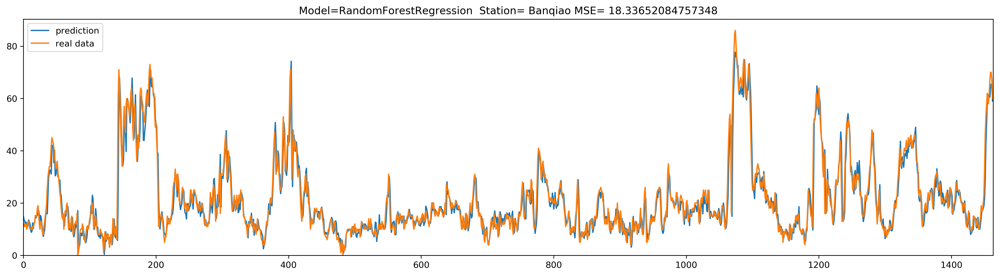

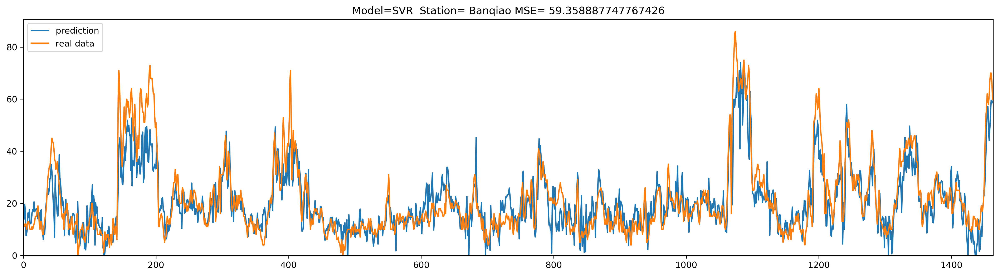

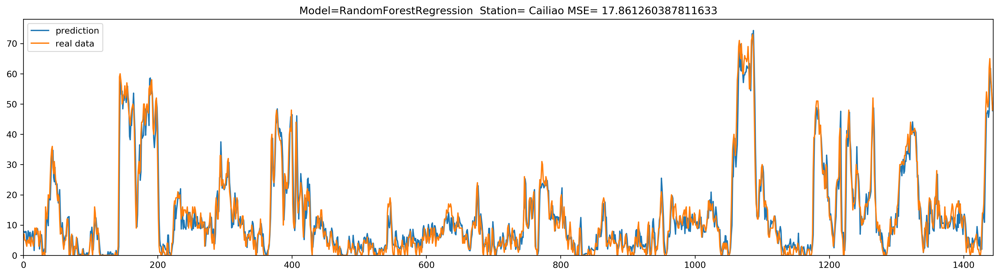

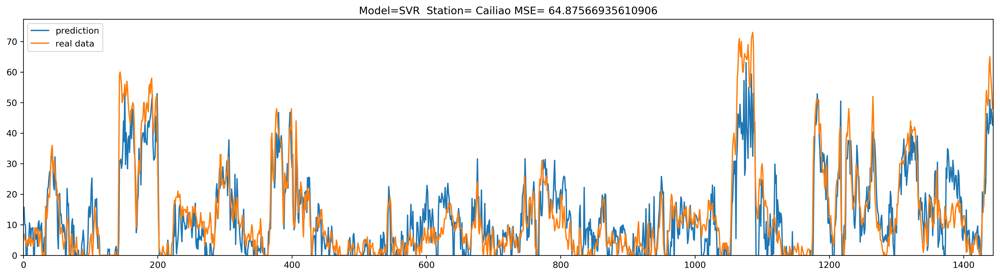

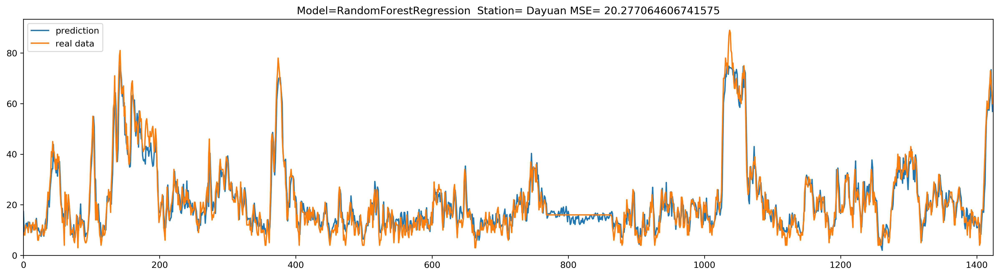

...

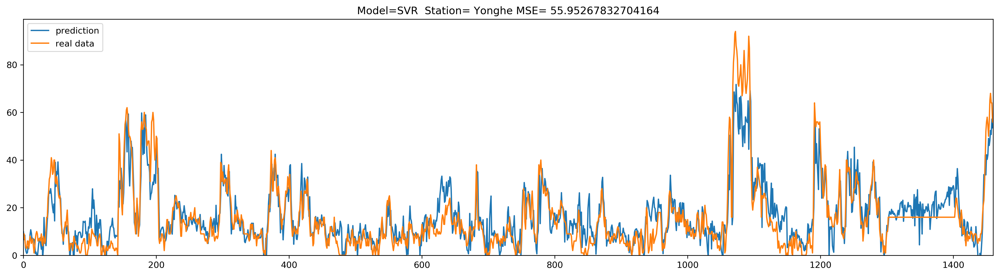

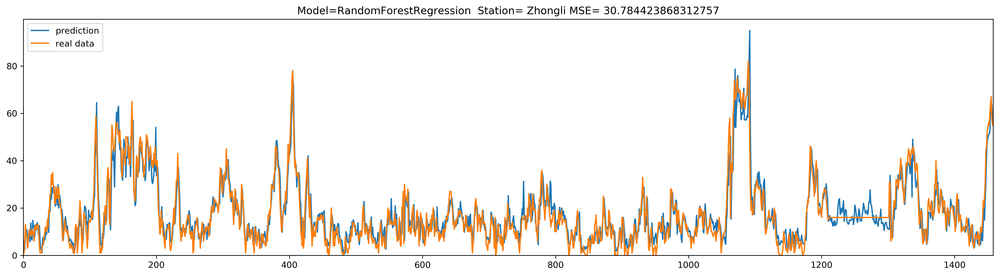

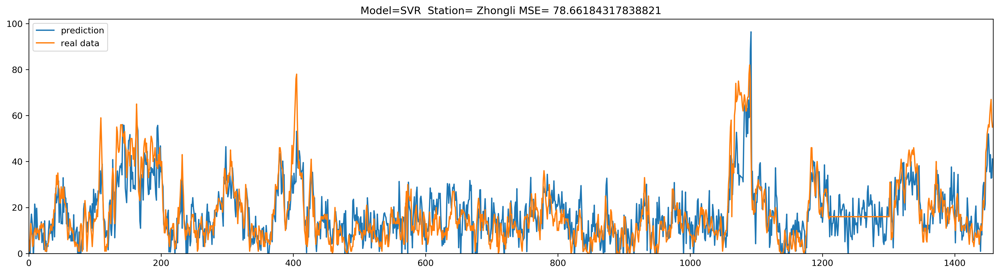

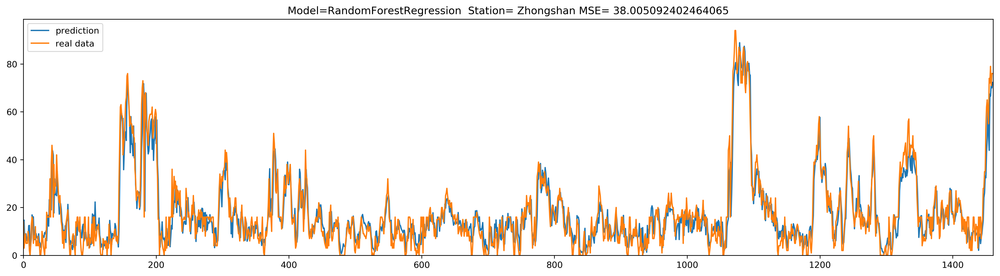

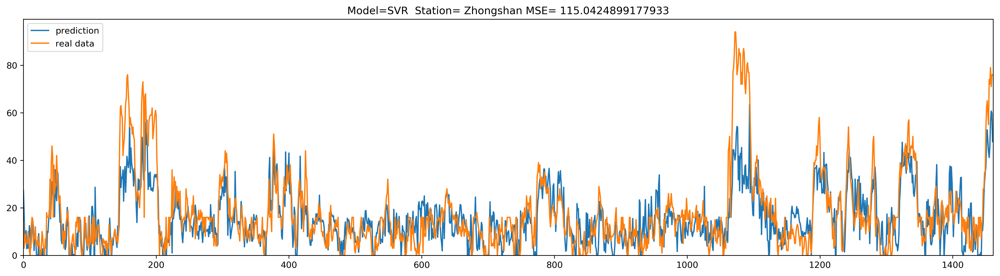

In [35]:
from sklearn import svm
from sklearn.metrics import mean_squared_error
import time
from sklearn.ensemble import RandomForestRegressor
for index,station in enumerate(air_pd.groupby('station').mean().index):
    air_pd_station=air_pd[air_pd['station']==station].sort_values(by=['year','month','day','hour'])   
    air_pd_station['next_hour_pm2.5'] = air_pd_station['PM2.5'].shift(-1)
    air_pd_station.drop(air_pd_station.index[-1],inplace=True)
    #air_pd_station['next_hour_pm2.5'] = air_pd_station['PM2.5'].shift(-1)
    X_train=air_pd_station[(air_pd_station['month']!=11) & (air_pd_station['month']!=12)].loc[:,'AMB_TEMP':'hour'].values  #Train INPUT feature
    Y_train=air_pd_station[(air_pd_station['month']!=11) & (air_pd_station['month']!=12)].loc[:,'next_hour_pm2.5'].values  #Train OUTPUT pm2.5
    #Y_train=air_pd_station[(air_pd_station['month']!=11) & (air_pd_station['month']!=12)].loc[:,'PM2.5'].values  #Train OUTPUT pm2.5
    X_test=air_pd_station[(air_pd_station['month']==11) | (air_pd_station['month']==12)].loc[:,'AMB_TEMP':'hour'].values
    Y_test=air_pd_station[(air_pd_station['month']==11) | (air_pd_station['month']==12)].loc[:,'next_hour_pm2.5'].values
    #Y_test=air_pd_station[(air_pd_station['month']==11) | (air_pd_station['month']==12)].loc[:,'PM2.5'].values

    print('=================== RandomForestRegressor ========================')
    g_search = RandomForestRegressor(n_jobs=-1)
    g_search.fit(X_train,Y_train)
    Y_pred = g_search.predict(X_test)
    Start=time.time()
    plt.figure(figsize=(20,5),dpi=300)
    End=time.time()
    print("Training time= %.2f" %(End-Start))
    MSE=mean_squared_error(Y_test,Y_pred)
    plt.title("Model=RandomForestRegression "+ " "+"Station= " + str(station)+" "+ "MSE=" + " " + str(MSE))
    plt.plot(Y_pred,label='prediction')
    plt.plot(Y_test,label='real data')
    plt.xlim(0,len(Y_test))
    plt.ylim(0,)
    _ =plt.legend(loc='upper left')
    print('MSE',mean_squared_error(Y_test, Y_pred))
    _=plt.legend(loc='upper left')
#     plt.savefig('RandomForestRegressor %s' %station)

    
    print('=================== SVR ========================')
    clf=svm.SVR(C=1e3, gamma=0.001)
    #clf=RandomForestRegressor()
    Start = time.time()
    clf.fit(X_train,Y_train)
    End= time.time()
    print("Training time= %.2f" %((End-Start)/60))
    Y_pred=clf.predict(X_test)
    print('MSE',mean_squared_error(Y_test,Y_pred))
    MSE=mean_squared_error(Y_test,Y_pred)
    plt.figure(figsize=(20,5),dpi=300)
    #plt.title('Banqiao' +"  "+ "Mean_Squared_Error" + str(MSE),fontsize=20)
    plt.title("Model=SVR "+ " "+"Station= " + str(station)+" "+ "MSE=" + " " + str(MSE))
    plt.plot(Y_pred,label='prediction')
    plt.plot(Y_test,label='real data')
    plt.xlim(0,len(Y_test))
    plt.ylim(0,)
    _ =plt.legend(loc='upper left')
    print('MSE',mean_squared_error(Y_test,Y_pred))
#     plt.savefig('SVR %s' %station)